## Circuit Identities

### Controlled-Z from CNOT
- CZ applies a Z gate to the target if the control is 1

In [10]:
from qiskit import * 

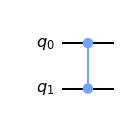

In [2]:
q  = QuantumCircuit(2)
q.cz(0,1)
q.draw('mpl')

- But, there are limitations to the actual implementations of the gates 
- **Example** - IBMQ only has support for the CX gates and thus this needs to be broken down into single qubit gates and the CX gate

- USEFUL IDENTITIES : 
$$HXH = Z$$ 
$$HZH = X$$

- Note since CX is a controlled X gate, if we use **H** before and after the target qubit in the circuit, we would have the effect of the CZ gate!

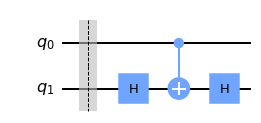

In [9]:
from random import getrandbits 
q = QuantumCircuit(2)
if(getrandbits(1)):
    q.x(0)
if(getrandbits(1)):
    q.x(1)
q.barrier()
q.h(1)
q.cx(0,1)
q.h(1)
q.draw('mpl')

### Testing 

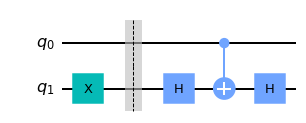

10
[0.+6.1232340e-17j 0.+0.0000000e+00j 1.-1.8369702e-16j 0.+0.0000000e+00j]


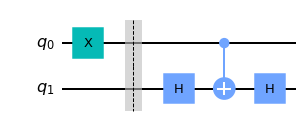

01
[0.+0.000000e+00j 1.-6.123234e-17j 0.+0.000000e+00j 0.+6.123234e-17j]


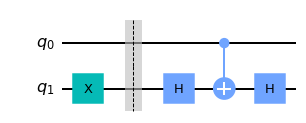

10
[0.+6.1232340e-17j 0.+0.0000000e+00j 1.-1.8369702e-16j 0.+0.0000000e+00j]


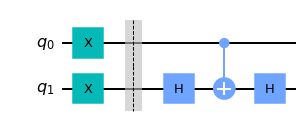

11
Phase was successfully flipped!
[ 0.+0.0000000e+00j  0.-6.1232340e-17j  0.+0.0000000e+00j
 -1.+1.8369702e-16j]


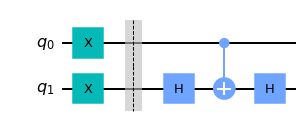

11
Phase was successfully flipped!
[ 0.+0.0000000e+00j  0.-6.1232340e-17j  0.+0.0000000e+00j
 -1.+1.8369702e-16j]


In [16]:
backend = Aer.get_backend('statevector_simulator')
for _ in range(5):
    q = QuantumCircuit(2)
    if(getrandbits(1)):
        q.x(0)
    if(getrandbits(1)):
        q.x(1)
    q.barrier()
    q.h(1)
    q.cx(0,1)
    q.h(1)
    display(q.draw('mpl'))
    state = execute(q,backend).result().get_statevector()
    c = 0
    for k in state:
        if(k.real != 0):
            print(bin(c)[2:].zfill(2))
            if(k.real < 0):
                print("Phase was successfully flipped!")
            break
        c+=1
    print(state)

### More generally, we can transform a single CNOT into a controlled version of any rotation around the Bloch sphere by an angle π, by simply preceding and following it with the correct rotations

- Note, that any rotation on the **Bloch Sphere** is ANTI - CLOCKWISE as seen from the axis
- This greatly helps in visualizing and making the controlled gates

## Swapping states
- This is achieved by the fredkin gate 
- Let us see how we can implement it

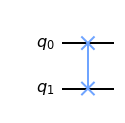

In [17]:
a = 0
b = 1
q = QuantumCircuit(2)
q.swap(a,b)
q.draw('mpl')

- If you use two CNOTs, the states flip 
- NOTE that the CNOTs flip your state twice if you had 11 
- For that, we need one additional CNOT at the end for the correction of this

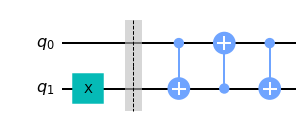

In [27]:
q = QuantumCircuit(2)
if(getrandbits(1)):
    q.x(0)
if(getrandbits(1)):
    q.x(1)
q.barrier()
q.cx(0,1)
q.cx(1,0)
q.cx(0,1)
q.draw('mpl')

### Testing


Q1 : 1
Q0 : 0


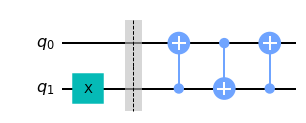

01
[0.+0.j 1.+0.j 0.+0.j 0.+0.j]

Q1 : 0
Q0 : 0


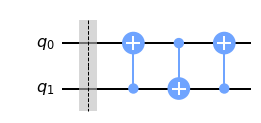

00
[1.+0.j 0.+0.j 0.+0.j 0.+0.j]

Q1 : 0
Q0 : 1


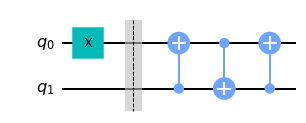

10
[0.+0.j 0.+0.j 1.+0.j 0.+0.j]

Q1 : 1
Q0 : 1


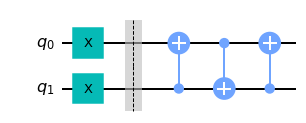

11
[0.+0.j 0.+0.j 0.+0.j 1.+0.j]

Q1 : 1
Q0 : 0


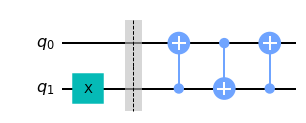

01
[0.+0.j 1.+0.j 0.+0.j 0.+0.j]


In [31]:
backend = Aer.get_backend('statevector_simulator')
for _ in range(5):
    q = QuantumCircuit(2)
    q0,q1 = getrandbits(1),getrandbits(1)
    if(q0):
        q.x(0)
    if(q1):
        q.x(1)
    print("\nQ1 :",q1)
    print("Q0 :",q0)
    q.barrier()
    q.cx(1,0)
    q.cx(0,1)
    q.cx(1,0)
    display(q.draw('mpl'))
    state = execute(q,backend).result().get_statevector()
    c = 0
    for k in state:
        if(k.real != 0):
            print(bin(c)[2:].zfill(2))
            break
        c+=1
    print(state)

## Swapping the |+> |-> state
- Well we just built CZ , let us use it! 
- Why? because CZ flips + to - and - to + !

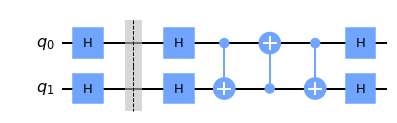

[0.5+6.16297582e-33j 0.5-6.12323400e-17j 0.5-6.12323400e-17j
 0.5-1.22464680e-16j]


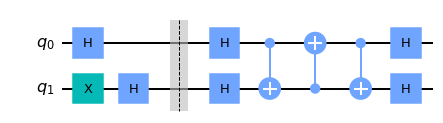

[ 0.5-1.2246468e-16j -0.5+1.8369702e-16j  0.5-1.8369702e-16j
 -0.5+2.4492936e-16j]


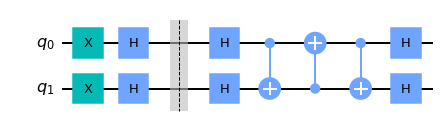

[ 0.5-2.4492936e-16j -0.5+3.0616170e-16j -0.5+3.0616170e-16j
  0.5-3.6739404e-16j]


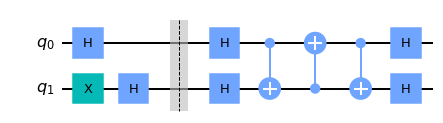

[ 0.5-1.2246468e-16j -0.5+1.8369702e-16j  0.5-1.8369702e-16j
 -0.5+2.4492936e-16j]


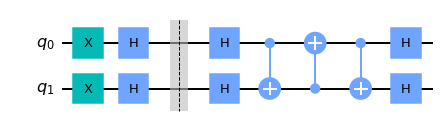

[ 0.5-2.4492936e-16j -0.5+3.0616170e-16j -0.5+3.0616170e-16j
  0.5-3.6739404e-16j]


In [37]:
backend = Aer.get_backend('statevector_simulator')
for _ in range(5):
    q = QuantumCircuit(2)
    q0,q1 = getrandbits(1),getrandbits(1)
    if(q0):
        q.x(0)
    if(q1):
        q.x(1)    
    q.h([0,1])
    # prepared the states 
    q.barrier()
    
    # let's do hadamard, 
    # apply normal swap 
    # and again do hadamard 
    q.h([0,1])
    
    q.cx(0,1)
    q.cx(1,0)
    q.cx(0,1)
    
    #reverse 
    q.h([0,1])
    
    # now measure statevector 
    display(q.draw('mpl'))
    state = execute(q,backend).result().get_statevector()
    print(state)

## Yes, working out the statevectors by hand proves that we get the flipped |+> and the |-> states

## A better way to make Toffoli
- Since CCNOT is just Controlled -Controlled - X so why not look for equivalent gates which implement this 
- We know -> HZH = X 

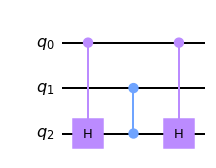

In [38]:
# let us use CH and CZ gates 
q= QuantumCircuit(3)
q.ch(0,2)
q.cz(1,2)
q.ch(0,2)
q.draw('mpl')

## Why does it work?
- If we have the state **|00>** at q0 and q1, then we see there is no change 
- If we have the state **|10>** means the q1 is **1**. This means a CZ is applied to the state at q2. Note that this is the same state upto a global phase and thus the state is essentially the same
- If we have the state **|01>** it means the q0 is 1 and we apply the H gate two times so its net effect is 0
- BUt, if we have the **|11>** state at q0 and q1, this means that we apply the H Z H to the last qubit and thus making the CCX behaviour with minimal gates

## Making Arbitrary Rotations
-  It is impossible to implement an angle **θ** with perfect accuracy, such that you are sure that you are not accidentally implementing something like  
$$\theta +0.0000001$$ 
- There will always be a limit to the accuracy we can actually achieve when we account for the imperfections in circuits

### Fault-tolerant schemes typically perform these rotations using multiple applications of just two gates: H and T.
- T gate is just a $$\frac{\pi}{4}$$ rotation around the Z - axis
- It is represented as - 
$$R_{z}(\pi / 4) = T = e ^{i\frac{\pi}{8}\sigma_{z}} = cos(\frac{\pi}{8})I - isin(\frac{\pi}{8})\sigma_{z}$$

- NOTE : The Sandwiching of an Rz(t) gate inside the two H gates produces an equivalent effect of Rx(t) gate

## T gate doing X rotation

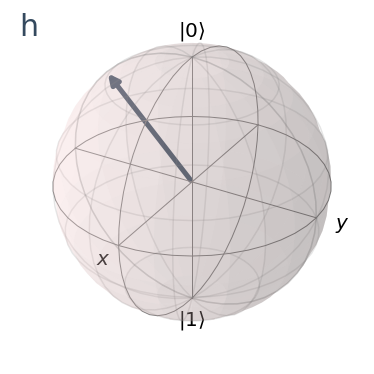

In [56]:
from qiskit.tools.visualization import plot_bloch_multivector,visualize_transition
import numpy as np
q = QuantumCircuit(1)
for _ in range(1):
    q.h(0)
    q.rz(np.pi/4,0)
    q.h(0)

state = execute(q,backend).result().get_statevector()
visualize_transition(q)
# plot_bloch_multivector(state)
